
### Example of the book - "Time Series Forecasting using Deep Learning" by Ivan Gridin


* In this kernel I will provide all the steps required for doing time series analysis using time series data and simple RNN models.

In [2]:
'''
    Example of the book - "Time Series Forecasting using Deep Learning" by Ivan Gridin
'''

import copy
import random
import sys
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import torch
import torch.nn as nn

from sklearn.preprocessing import MinMaxScaler

import os
for dirname, _, filenames in os.walk('../deeplearning/archive'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

../deeplearning/archive\AEP_hourly.csv
../deeplearning/archive\COMED_hourly.csv
../deeplearning/archive\DAYTON_hourly.csv
../deeplearning/archive\DEOK_hourly.csv
../deeplearning/archive\DOM_hourly.csv
../deeplearning/archive\DUQ_hourly.csv
../deeplearning/archive\EKPC_hourly.csv
../deeplearning/archive\est_hourly.paruqet
../deeplearning/archive\FE_hourly.csv
../deeplearning/archive\NI_hourly.csv
../deeplearning/archive\PJME_hourly.csv
../deeplearning/archive\PJMW_hourly.csv
../deeplearning/archive\pjm_hourly_est.csv
../deeplearning/archive\PJM_Load_hourly.csv


In [13]:
def get_aep_timeseries():
    df = pd.read_csv('../deeplearning/archive/AEP_hourly.csv')
    ts = df['AEP_MW'].astype(int).values.reshape(-1, 1)[-3000:]
    return ts

In [15]:
def get_pjme_timeseries():
    df = pd.read_csv('../deeplearning/archive/PJME_hourly.csv')
    ts = df['PJME_MW'].astype(int).values.reshape(-1, 1)[-3000:]
    return ts

In [16]:
def get_ni_timeseries():
    df = pd.read_csv('../deeplearning/archive/NI_hourly.csv')
    ts = df['NI_MW'].astype(int).values.reshape(-1, 1)[-3000:]
    return ts

In [21]:
def sliding_window(ts, features):
    X = []
    Y = []

    for i in range(features + 1, len(ts) + 1):
        X.append(ts[i - (features + 1):i - 1])
        Y.append([ts[i - 1]])

    print("sliding window X: ", X)
    print("sliding window Y: ", Y)
    return X, Y

In [9]:
def get_training_datasets(ts, features, test_len):
    X, Y = sliding_window(ts, features)

    X_train, Y_train, X_test, Y_test = X[0:-test_len], Y[0:-test_len], X[-test_len:], Y[-test_len:]

    train_len = round(len(ts) * 0.7)

    X_train, X_val, Y_train, Y_val = X_train[0:train_len], X_train[train_len:], Y_train[0:train_len], Y_train[train_len:]

    x_train = torch.tensor(data = X_train).float()
    y_train = torch.tensor(data = Y_train).float()

    x_val = torch.tensor(data = X_val).float()
    y_val = torch.tensor(data = Y_val).float()

    x_test = torch.tensor(data = X_test).float()
    y_test = torch.tensor(data = Y_test).float()

    return x_train, x_val, x_test, y_train.squeeze(1), y_val.squeeze(1), y_test.squeeze(1)

### AEP Hourly

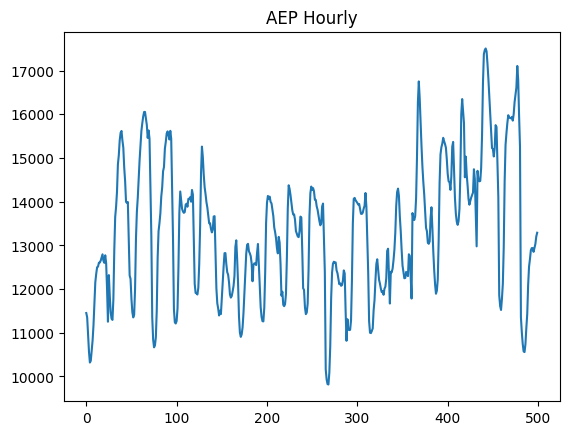

In [14]:
plt.title('AEP Hourly')
plt.plot(get_aep_timeseries()[:500])
plt.show()

### RNN

In [17]:
class RNN(nn.Module):

    def __init__(self, hidden_size, in_size = 1, out_size = 1):
        super(RNN, self).__init__()
        self.rnn = nn.RNN(input_size = in_size, hidden_size = hidden_size, batch_first = True)
        self.fc = nn.Linear(hidden_size, out_size)

    def forward(self, x, h = None):
        out, _ = self.rnn(x, h)
        last_hidden_states = out[:, -1]
        out = self.fc(last_hidden_states)
        return out, last_hidden_states

In [18]:
random.seed(1)
torch.manual_seed(1)

In [19]:
features = 240
test_ts_len = 300
rnn_hidden_size = 24
learning_rate = 0.02
training_epochs = 500

In [22]:
ts = get_aep_timeseries()
scaler = MinMaxScaler()
scaled_ts = scaler.fit_transform(ts)
x_train, x_val, x_test, y_train, y_val, y_test = get_training_datasets(scaled_ts, features, test_ts_len)

sliding window X:  [array([[0.12639061],
       [0.11874227],
       [0.08899876],
       [0.05801916],
       [0.03878245],
       [0.04194994],
       [0.0598733 ],
       [0.07779666],
       [0.10491347],
       [0.14446848],
       [0.18070148],
       [0.19561187],
       [0.20735476],
       [0.20843634],
       [0.21538937],
       [0.21569839],
       [0.21917491],
       [0.22504635],
       [0.2302225 ],
       [0.21871137],
       [0.21508035],
       [0.22844561],
       [0.21461681],
       [0.16903585],
       [0.11101669],
       [0.1934487 ],
       [0.15706119],
       [0.12801298],
       [0.11634734],
       [0.11418418],
       [0.15080346],
       [0.23702101],
       [0.2960445 ],
       [0.31435414],
       [0.34069839],
       [0.38921508],
       [0.4052843 ],
       [0.43178307],
       [0.44507108],
       [0.44839308],
       [0.43162855],
       [0.41872682],
       [0.38349815],
       [0.35962608],
       [0.3230068 ],
       [0.32122991],
       [0.3226

In [23]:
model = RNN(hidden_size = rnn_hidden_size)
model.train()

RNN(
  (rnn): RNN(1, 24, batch_first=True)
  (fc): Linear(in_features=24, out_features=1, bias=True)
)

In [24]:
optimizer = torch.optim.Adam(params = model.parameters(), lr = learning_rate)
mse_loss = torch.nn.MSELoss()
best_model = None
min_val_loss = sys.maxsize
training_loss = []
validation_loss = []

for t in range(training_epochs):
    prediction, _ = model(x_train)
    loss = mse_loss(prediction, y_train)
    
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    
    val_prediction, _ = model(x_val)
    val_loss = mse_loss(val_prediction, y_val)
    
    training_loss.append(loss.item())
    validation_loss.append(val_loss.item())
    
    if val_loss.item() < min_val_loss:
        best_model = copy.deepcopy(model)
        min_val_loss = val_loss.item()
        
    if t%50 == 0:
        print(f'epoch: {t}, train: {round(loss.item(), 4)}, val: {round(val_loss.item(), 4)}')

epoch: 0, train: 0.377, val: 0.0866
epoch: 50, train: 0.0061, val: 0.0133
epoch: 100, train: 0.0021, val: 0.0044
epoch: 150, train: 0.0018, val: 0.0034
epoch: 200, train: 0.0015, val: 0.003
epoch: 250, train: 0.0014, val: 0.0027
epoch: 300, train: 0.0013, val: 0.0026
epoch: 350, train: 0.0012, val: 0.0025
epoch: 400, train: 0.0012, val: 0.0024
epoch: 450, train: 0.0012, val: 0.0024


In [25]:
best_model.eval()
_, h_list = best_model(x_val)

h = (h_list[-1, :]).unsqueeze(-2)
predicted = []

for test_seq in x_test.tolist():
    x = torch.Tensor(data = [test_seq])
    y, h = best_model(x, h.unsqueeze(-2))
    
    unscaled = scaler.inverse_transform(np.array(y.item()).reshape(-1, 1))[0][0]
    predicted.append(unscaled)

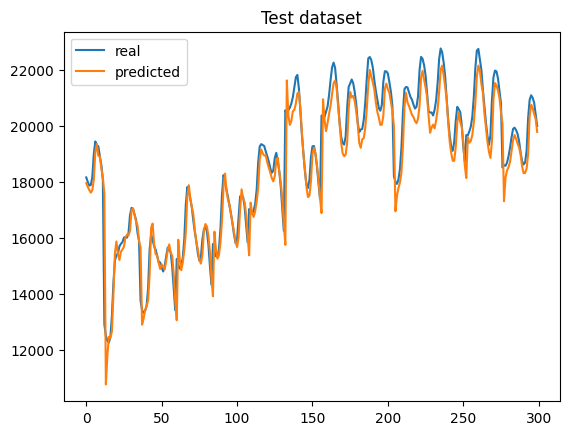

In [26]:
real = scaler.inverse_transform(y_test.tolist())

plt.title('Test dataset')
plt.plot(real, label = 'real')
plt.plot(predicted, label = 'predicted')
plt.legend()
plt.show()

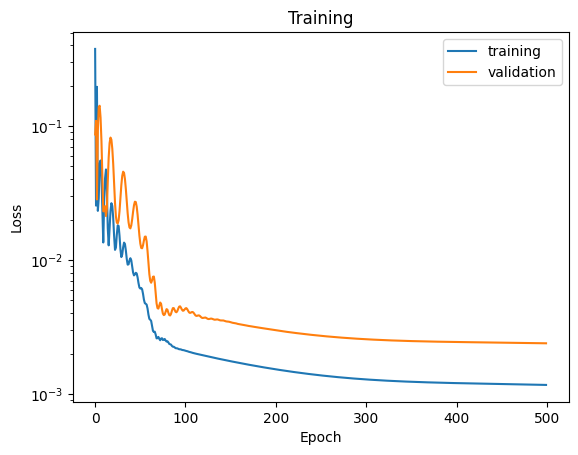

In [27]:
plt.title('Training')
plt.yscale('log')
plt.plot(training_loss, label = 'training')
plt.plot(validation_loss, label = 'validation')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()